# Figures for Chapter 5

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

plt.rcParams['figure.dpi'] = 500
plt.rcParams['font.family'] = 'Microsoft YaHei'
plt.rcParams['axes.unicode_minus'] = False

# colors
BLUE = '#2878B5'
LIGHTBLUE = '#9AC9DB'
ORANGE = '#F8AC8C'
RED = '#C82423'
PINK = '#FF8884'
GREY = '#9E9E9E'
DEEPGREEN = '#32B897'
GREEN = '#96CCCB'

In [2]:
from analysis import Aggregator
agg = Aggregator()
SPEED_BIN = agg.SPEED_BIN
DECEL_BIN = agg.BRAKE_DECEL_BIN

import numpy as np
OpModeERs = np.load("./data/agg/OpModeERs.npy")

## Temporal

In [3]:
import pickle
with open("./data/agg/agg_date.pkl", 'rb') as f:
    agg_date = pickle.load(f)

agg_date['brakeFrac'] = agg_date['brakeCount'] / agg_date['trajCount']
agg_date['brakeFreq'] = agg_date['brakeEventNum'] / agg_date['mileage']  # #/km
agg_date['brakeTimeMean'] = agg_date['brakeCount'] / agg_date['brakeEventNum']  # sec
agg_date['brakeDecelBinFrac'] = agg_date['brakeDecelBinCount'] / agg_date['brakeCount']
agg_date['OpModeFrac'] = agg_date['OpModeCount'] / agg_date['trajCount']
agg_date['PM10 ER Avg'] = agg_date['OpModeFrac'].apply(lambda x: sum(x * OpModeERs))  # g/hr
agg_date['Daily BWE'] = agg_date['PM10 ER Avg'] * agg_date['trajCount'] / 3600  # g
agg_date['PM10 EF Avg'] = agg_date['Daily BWE'] / agg_date['mileage'] * 1000  # mg/km/veh

In [27]:
agg_date.loc[[4, 11, 18, 25]]['brakeFrac'].mean()

0.34260715324652546

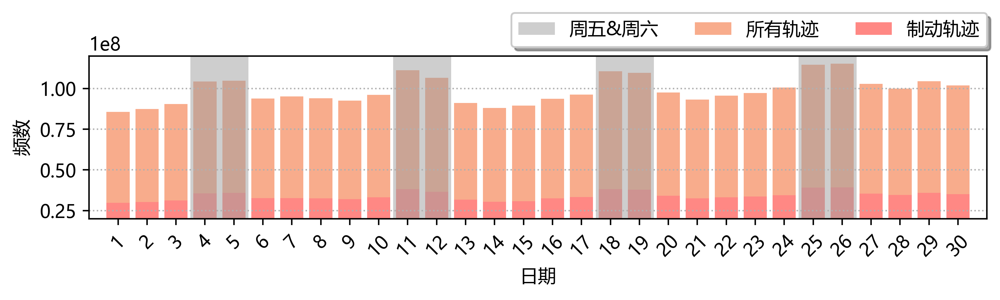

In [34]:
fig, ax = plt.subplots(1,1, figsize=(7.5,2), constrained_layout=True)

# count-bar
dates = np.arange(1,31)
ax.bar(dates, agg_date['trajCount'], color=ORANGE, label="所有轨迹")
ax.bar(dates, agg_date['brakeCount'], color=PINK, label="制动轨迹")

# span
weekend= np.array([4, 11, 18, 25])
for id, fri in enumerate(weekend):
    if id == 0:
        ax.axvspan(fri-0.5, fri+1.5, facecolor=GREY, alpha=0.5, label="周五&周六")
    else:
        ax.axvspan(fri-0.5, fri+1.5, facecolor=GREY, alpha=0.5)

ax.set_xlim(0,31)
ax.set_ylim(0.2*10**8,1.2*10**8)
ax.set_xticks(dates)
ax.set_xticklabels(dates, rotation=45)

# frac-scatter
# ax_ = ax.twinx()
# ax_.scatter(dates, agg_date['brakeFrac']*100, color="k", marker="x", label="制动时间占比")
# ax_.set_ylim(32, 37)

# labels
ax.set_xlabel("日期")
ax.set_ylabel("频数")
# ax_.set_ylabel("制动时间占比（%）")
ax.grid(linestyle=":", axis="y")

fig.legend(loc=1, bbox_to_anchor=(1.01,1.32), bbox_transform=ax.transAxes, ncol=4, shadow=True)
# 1.01,1.35
plt.show()

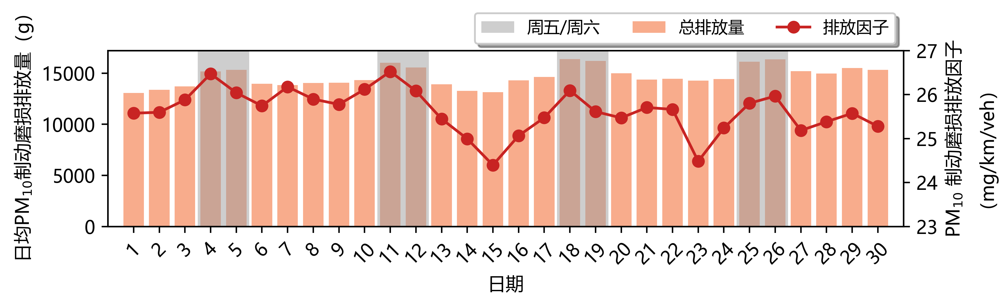

In [20]:
fig, ax = plt.subplots(1,1, figsize=(7.5,2), constrained_layout=True)

# BWE
dates = np.arange(1,31)
ax.bar(dates, agg_date['Daily BWE'], color=ORANGE, label="总排放量")
ax.set_xlim(0,31)
ax.set_xticks(dates)
ax.set_xticklabels(dates, rotation=45)
ax.set_xlabel("日期")
ax.set_ylabel("日均PM$_{10}$制动磨损排放量（g）")

# span
weekend= np.array([4, 11, 18, 25])
for id, fri in enumerate(weekend):
    if id == 0:
        ax.axvspan(fri-0.5, fri+1.5, facecolor=GREY, alpha=0.5, label="周五/周六")
    else:
        ax.axvspan(fri-0.5, fri+1.5, facecolor=GREY, alpha=0.5)

# plot
ax_ = ax.twinx()
ax_.plot(dates, agg_date['PM10 EF Avg'], color=RED, marker="o", label="排放因子")
ax_.set_ylabel("PM$_{10}$ 制动磨损排放因子\n（mg/km/veh）")
ax_.set_ylim(23, 27)

# labels
fig.legend(loc=1, bbox_to_anchor=(1,1.26), bbox_transform=ax.transAxes, ncol=3, shadow=True, fontsize=9)
plt.show()

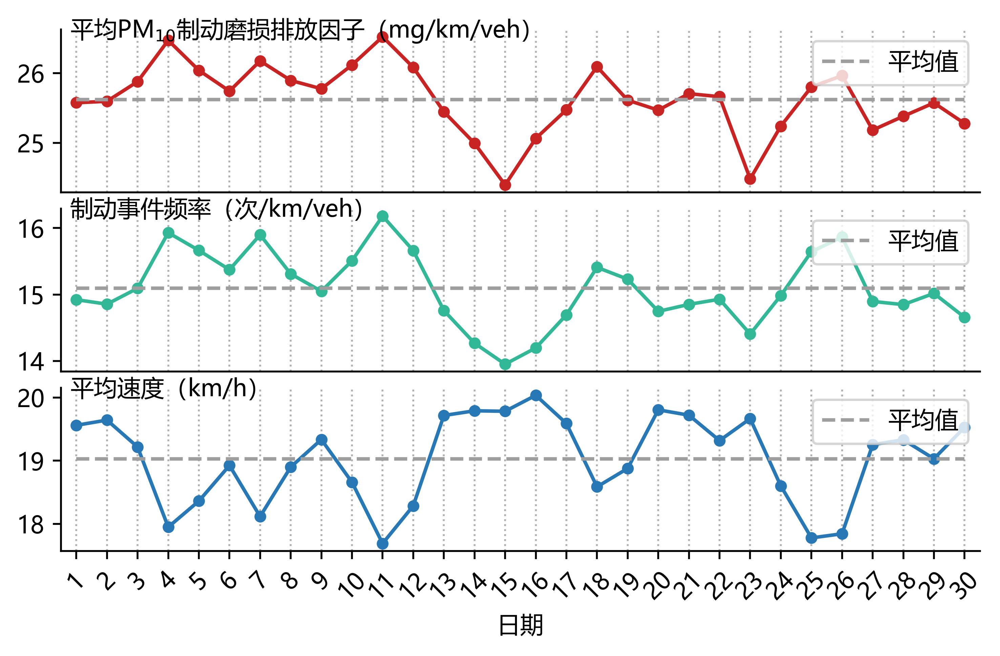

In [5]:
fig, ax = plt.subplots(3,1,figsize=(7,4))
ax = ax.flatten()

dates = np.arange(1,31,1)
agg_date_speed = agg_date.apply(lambda x: sum(x['speedBinCount'] / x['trajCount'] * SPEED_BIN[:-1]), axis=1)
agg_date_freq = agg_date['brakeFreq']
agg_date_time = agg_date['brakeTimeMean']
agg_date_decel = agg_date.apply(lambda x: sum(x['brakeDecelBinCount'] / x['trajCount'] * DECEL_BIN[:-1]), axis=1)

ax[0].plot(dates, agg_date['PM10 EF Avg'], color=RED, marker='o', markersize=4)
ax[0].hlines(agg_date['PM10 EF Avg'].mean(), 1, 30, color=GREY, linestyle='--', label='平均值')
ax[0].text(0.01, 0.95, "平均PM$_{10}$制动磨损排放因子（mg/km/veh）", transform=ax[0].transAxes, fontsize=10, ha='left')

ax[1].plot(dates, agg_date_freq, color=DEEPGREEN, marker='o', markersize=4)
ax[1].hlines(agg_date_freq.mean(), 1, 30, color=GREY, linestyle='--', label='平均值')
ax[1].text(0.01, 0.95, "制动事件频率（次/km/veh）", transform=ax[1].transAxes, fontsize=10, ha='left')

ax[2].plot(dates, agg_date_speed, color=BLUE, marker='o', markersize=4)
ax[2].hlines(agg_date_speed.mean(), 1, 30, color=GREY, linestyle='--', label='平均值')
ax[2].text(0.01, 0.95, "平均速度（km/h）", transform=ax[2].transAxes, fontsize=10, ha='left')

# ax[3].plot(dates, agg_date_time, color=ORANGE, marker='o', markersize=4)
# ax[3].hlines(agg_date_time.mean(), 1, 30, color=GREY, linestyle='--', label='平均值')
# ax[3].text(0.01, 0.95, "平均制动持续时间（s）", transform=ax[3].transAxes, fontsize=10, ha='left')

# ax[4].plot(dates, agg_date_decel, color=PINK, marker='o', markersize=4)
# ax[4].hlines(agg_date_decel.mean(), 1, 30, color=GREY, linestyle='--', label='平均值')
# ax[4].text(0.01, 0.95, "平均制动减速度（m/s$^2$）", transform=ax[4].transAxes, fontsize=10, ha='left')

# ticks
for ax_ in [ax[0], ax[1]]:
    ax_.set_xticks(dates, [])
    ax_.tick_params(bottom=False)

ax[2].set_xlabel("日期")
ax[2].set_xticks(dates)
ax[2].set_xticklabels(dates, rotation=45)

# axis
for ax_ in ax:
    ax_.set_xlim(0.5, 30.5)
    ax_.legend(loc=1)
    ax_.grid(axis='x', linestyle=":")
    ax_.spines['top'].set_visible(False)
    ax_.spines['right'].set_visible(False)
    ax_.yaxis.set_label_position('right')
plt.subplots_adjust(hspace=0.1)
plt.show()

In [14]:
from analysis import Aggregator
agg = Aggregator()
SPEED_BIN = agg.SPEED_BIN
DECEL_BIN = agg.BRAKE_DECEL_BIN

import numpy as np
OpModeERs = np.load("./data/agg/OpModeERs.npy")

with open("./data/agg/agg_hour.pkl", 'rb') as f:
    agg_hour = pickle.load(f)
    
agg_hour['brakeFrac'] = agg_hour['brakeCount'] / agg_hour['trajCount']
agg_hour['brakeFreq'] = agg_hour['brakeEventNum'] / agg_hour['mileage']  # #/km
agg_hour['brakeTimeMean'] = agg_hour['brakeCount'] / agg_hour['brakeEventNum']  # sec
agg_hour['brakeDecelBinFrac'] = agg_hour['brakeDecelBinCount'] / agg_hour['brakeCount']
agg_hour['OpModeFrac'] = agg_hour['OpModeCount'] / agg_hour['trajCount']
agg_hour['PM10 ER Avg'] = agg_hour['OpModeFrac'].apply(lambda x: sum(x * OpModeERs))
agg_hour['Hourly BWE'] = agg_hour['PM10 ER Avg'] * agg_hour['trajCount'] / 3600 / 30
agg_hour['PM10 EF Avg'] = agg_hour['Hourly BWE'] / agg_hour['mileage'] * 30 * 1000  # mg/km/veh

In [39]:
agg_hour.loc[list(range(9,20))]['trajCount'].mean()

190473970.1818182

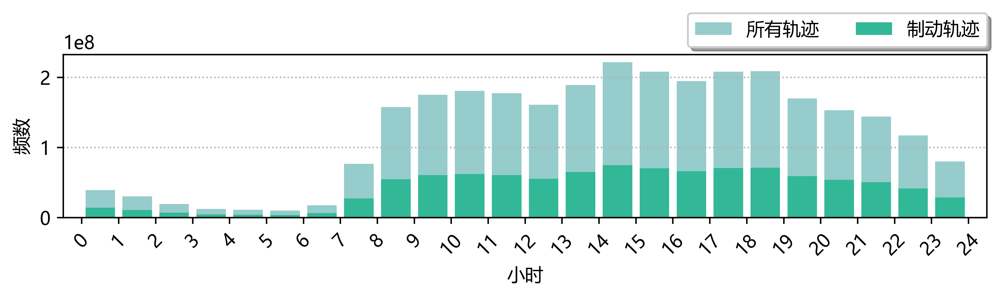

In [33]:
fig, ax = plt.subplots(1,1, figsize=(7.5,2), constrained_layout=True)


# count-bar
hours = np.arange(0,24)
ax.bar(hours+0.5, agg_hour['trajCount'], color=GREEN, label="所有轨迹")
ax.bar(hours+0.5, agg_hour['brakeCount'], color=DEEPGREEN, label="制动轨迹")

ax.set_xlim(-0.5,24.5)
# ax.set_ylim(0,1.55*10**8)
ax.set_xticks(np.arange(0, 25))
ax.set_xticklabels(np.arange(0, 25), rotation=45)

# # frac-scatter
# ax_ = ax.twinx()
# ax_.scatter(hours+0.5, agg_hour['brakeFrac']*100, color="k", marker="x", label="制动时间占比")
# ax_.set_ylim(32, 37)

# labels
# ax.text(-0.1, 1.2, "(b)", transform=ax.transAxes, fontsize=15)
ax.set_xlabel("小时")
ax.set_ylabel("频数")
# ax_.set_ylabel("制动时间占比（%）")
ax.grid(linestyle=":", axis="y")
fig.legend(loc=1, bbox_to_anchor=(1.01,1.31), bbox_transform=ax.transAxes, ncol=3, shadow=True)
plt.show()

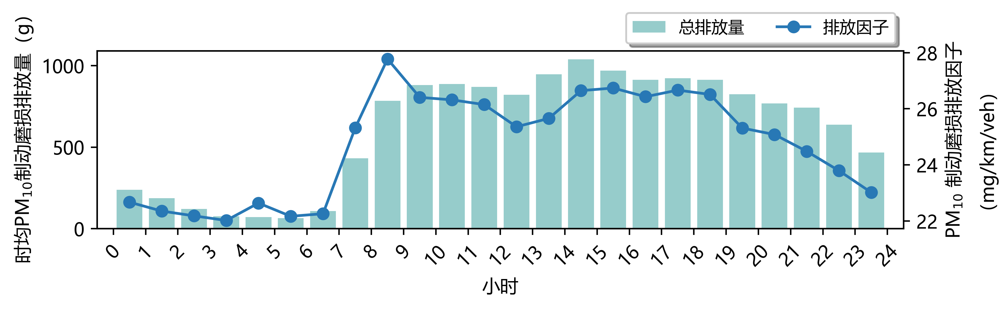

In [25]:
fig, ax = plt.subplots(1,1, figsize=(7.5,2), constrained_layout=True)

# hourly BWE
hours = np.arange(0,24)
ax.bar(hours+0.5, agg_hour['Hourly BWE'], color=GREEN, label="总排放量")
ax.set_xlim(-0.5,24.5)
ax.set_xticks(np.arange(0, 25))
ax.set_xticklabels(np.arange(0, 25), rotation=45)
ax.set_xlabel("小时")
ax.set_ylabel("时均PM$_{10}$制动磨损排放量（g）")

# amount plot
ax_ = ax.twinx()
ax_.plot(hours+0.5, agg_hour['PM10 EF Avg'], color=BLUE, marker="o", label="排放因子")
ax_.set_ylabel("PM$_{10}$ 制动磨损排放因子\n（mg/km/veh）")
# ax_.set_ylim(33.5, 40)
fig.legend(loc=1, bbox_to_anchor=(1,1.26), bbox_transform=ax.transAxes, ncol=2, shadow=True, fontsize=9)
plt.show()

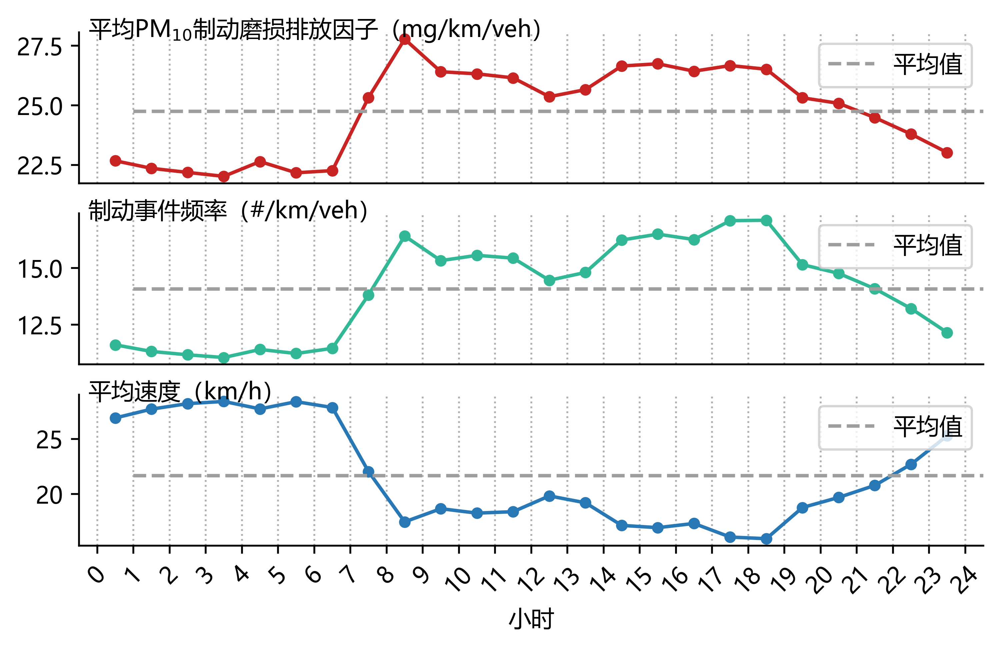

In [7]:
fig, ax = plt.subplots(3,1,figsize=(7,4))
ax = ax.flatten()

hours = np.arange(0,24,1)
agg_hour_speed = agg_hour.apply(lambda x: sum(x['speedBinCount'] / x['trajCount'] * SPEED_BIN[:-1]), axis=1)
agg_hour_freq = agg_hour['brakeFreq']
agg_hour_time = agg_hour['brakeTimeMean']
agg_hour_decel = agg_hour.apply(lambda x: sum(x['brakeDecelBinCount'] / x['trajCount'] * DECEL_BIN[:-1]), axis=1)

ax[0].plot(hours+0.5, agg_hour['PM10 EF Avg'], color=RED, marker='o', markersize=4)
ax[0].hlines(agg_hour['PM10 EF Avg'].mean(), 1, 30, color=GREY, linestyle='--', label="平均值")
ax[0].text(0.01, 0.97, "平均PM$_{10}$制动磨损排放因子（mg/km/veh）", transform=ax[0].transAxes, fontsize=10, ha='left')

ax[1].plot(hours+0.5, agg_hour_freq, color=DEEPGREEN, marker='o', markersize=4)
ax[1].hlines(agg_hour_freq.mean(), 1, 30, color=GREY, linestyle='--', label="平均值")
ax[1].text(0.01, 0.97, "制动事件频率（#/km/veh）", transform=ax[1].transAxes, fontsize=10, ha='left')

ax[2].plot(hours+0.5, agg_hour_speed, color=BLUE, marker='o', markersize=4)
ax[2].hlines(agg_hour_speed.mean(), 1, 30, color=GREY, linestyle='--', label="平均值")
ax[2].text(0.01, 0.97, "平均速度（km/h）", transform=ax[2].transAxes, fontsize=10, ha='left')

# ax[3].plot(hours+0.5, agg_hour_time, color=ORANGE, marker='o', markersize=4)
# ax[3].hlines(agg_hour_time.mean(), 1, 30, color=GREY, linestyle='--', label="平均值")
# ax[3].text(0.01, 0.97, "平均制动持续时间（s）", transform=ax[3].transAxes, fontsize=10, ha='left')

# ax[4].plot(hours+0.5, agg_hour_decel, color=PINK, marker='o', markersize=4)
# ax[4].hlines(agg_hour_decel.mean(), 1, 30, color=GREY, linestyle='--', label="平均值")
# ax[4].text(0.01, 0.97, "平均制动减速度（m/s$^2$）", transform=ax[4].transAxes, fontsize=10, ha='left')

# ticks
for ax_ in [ax[0], ax[1]]:
    ax_.set_xticks(hours, [])
    ax_.tick_params(bottom=False)

ax[2].set_xlabel("小时")
ax[2].set_xticks(np.arange(0, 25))
ax[2].set_xticklabels(np.arange(0, 25), rotation=45)

# axis
for ax_ in ax:
    ax_.set_xlim(-0.5,24.5)
    ax_.set_xticks(np.arange(0, 25))
    ax_.legend(loc=1)
    ax_.grid(axis='x', linestyle=":")
    ax_.spines['top'].set_visible(False)
    ax_.spines['right'].set_visible(False)
    ax_.yaxis.set_label_position('right')
plt.subplots_adjust(hspace=0.2)
plt.show()

## Spatial

In [3]:
import pickle
with open("./data/agg/agg_link.pkl", 'rb') as f:
    agg_link = pickle.load(f)

import geopandas as gpd
roadnet = gpd.read_file("./data/geo/roadnet/roadnet_simplified.shp")

# link-level aggregation
agg_link = agg_link.join(roadnet.set_index('osmid'))
agg_link = gpd.GeoDataFrame(agg_link, geometry='geometry')

# parameter calculation
def calParams(aggFile):
    aggFile['brakeFrac'] = aggFile['brakeCount'] / aggFile['trajCount']
    aggFile['brakeFreq'] = aggFile['brakeEventNum'] / aggFile['mileage']  # #/km
    aggFile['brakeTimeMean'] = aggFile['brakeCount'] / aggFile['brakeEventNum']  # sec
    aggFile['OpModeFrac'] = aggFile['OpModeCount'] / aggFile['trajCount']
    aggFile['brakeDecelMean'] = aggFile['brakeDecelMean'].apply(np.abs)
    aggFile['PM10 ER Avg'] = aggFile['OpModeFrac'].apply(lambda x: sum(x * OpModeERs))
    aggFile['Daily BWE'] = aggFile['PM10 ER Avg'] * aggFile['trajCount'] / 3600 / 30
    aggFile['PM10 EF Avg'] = aggFile['Daily BWE'] * 30 / aggFile['mileage'] * 1000  # mg/km/veh
    aggFile.replace(np.inf, 0, inplace=True)
    return aggFile
agg_link.dropna(inplace=True)
agg_link = calParams(agg_link)
int_col = ['trajCount', 'brakeCount', 'brakeEventNum']
float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'length', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
agg_link[int_col] = agg_link[int_col].astype('int32')
agg_link[float_col] = agg_link[float_col].astype('float32')
agg_link['trajVol'] = agg_link['trajCount'] / agg_link['length'] * 1000 / 30 / 24 # #/km/h

In [4]:
# road types
highway_types = [
    "motorway", "trunk", "primary", "secondary", "tertiary", "unclassified", "residential","living_street",
    "service", "motorway_link", "trunk_link", "primary_link", "secondary_link", "tertiary_link", 
]
highway_types_CN = [
    "高速公路", "快速路", "一级公路", "二级公路", "三级公路", "未分类道路", "居住区道路","生活街道",
    "服务性道路", "高速公路匝道", "快速路匝道", "一级公路连接线", "二级公路连接线", "三级公路连接线", 
]
# bound
east, west, north, south = 104.1269937640354, 104.03967976411019, 30.73017827690331, 30.655405046818046

### Road type

C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_20220\2756052789.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('Spectral', 14) # define the colormap


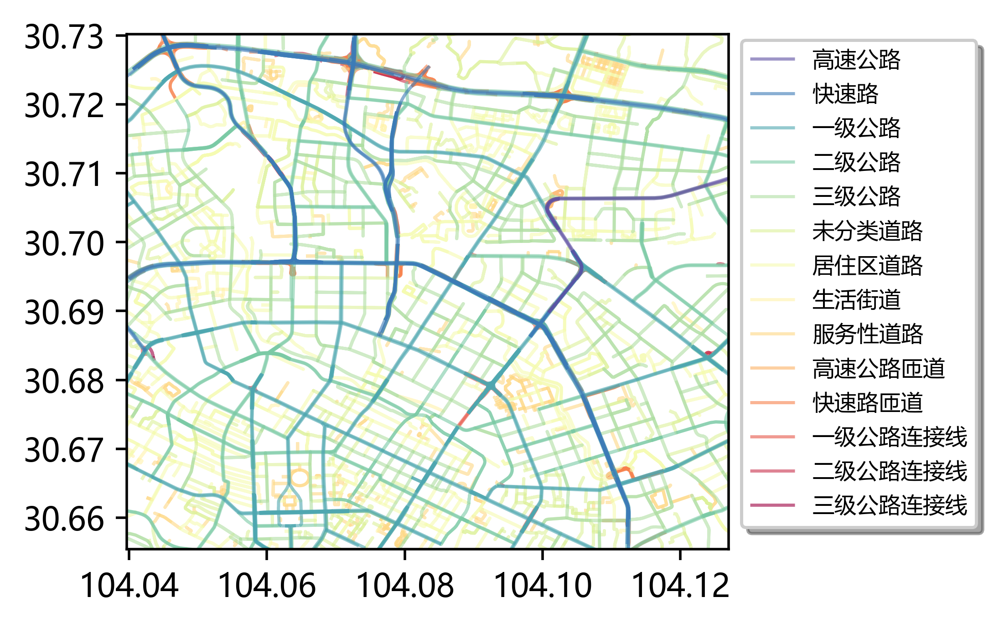

In [58]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

# extract all colors from cmap
cmap = plt.cm.get_cmap('Spectral', 14) # define the colormap
cmaplist = [cmap(i) for i in range(cmap.N)]

roadtypes = list(reversed(highway_types))
roadtypes_CN = list(reversed(highway_types_CN))
for i, roadtype in enumerate(roadtypes):
    agg_link[agg_link['road type'] == roadtype].plot(ax=ax, linewidth=1, color=cmaplist[i], alpha=0.6, label=roadtypes_CN[i])

ax.set_xlim(west, east)
ax.set_ylim(south, north)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.43, 1.01), bbox_transform=ax.transAxes, fontsize=7, shadow=True)
plt.show()

### Road type aggregation

In [5]:
import pickle
with open("./data/agg/agg_type.pkl", 'rb') as f:
    agg_type = pickle.load(f)

# calculate
agg_type = calParams(agg_type)
agg_type = agg_type.loc[highway_types]
agg_type['trajVol'] = agg_type['trajCount'] / agg_type['length'] * 1000 / 30 / 24 # #/km/h

In [6]:
with open("./data/agg/agg_node.pkl", 'rb') as f:
    agg_node = pickle.load(f)

# calculate parameters
agg_node['brakeEventNum'] = agg_node['brakeEventNum'].astype('float32')
agg_node['brakeCount'] = agg_node['brakeCount'].astype('int32')
agg_node = calParams(agg_node)
agg_node.fillna(value=0, inplace=True)
int_col = ['trajCount', 'brakeCount', 'brakeEventNum']
float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'brakeFrac', 'brakeFreq', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
agg_node[int_col] = agg_node[int_col].astype('int32')
agg_node[float_col] = agg_node[float_col].astype('float32')

import geopandas as gpd
nodes = gpd.read_file("./data/geo/nodes/nodes.shp")

# link-level aggregation
agg_node = agg_node.join(nodes.set_index('osmid'))  # add geo info
agg_node = gpd.GeoDataFrame(agg_node, geometry='geometry')  # transfer to gdf
agg_node.fillna(value='unsignalized', inplace=True)
agg_node = agg_node[agg_node['street_cou'] > 1]  # consider >2 links only
agg_node['length'] = agg_node['street_cou'] * 20  # length
agg_node['trajVol'] = agg_node['trajCount'] / agg_node['length'] * 1000 / 30 / 24 # #/km/h

In [8]:
# cumulative data
agg_node_cum = agg_node.copy()
for col in ['speedMean', 'accMean', 'VSPMean', 'brakeDecelMean']:
    agg_node_cum[col] = agg_node_cum[col] * agg_node_cum['trajCount']
agg_node_cum = agg_node_cum[['trajCount', 'brakeCount', 'brakeEventNum', 'mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'OpModeCount', 'length']].sum()

# mean data
for col in ['speedMean', 'accMean', 'VSPMean', 'brakeDecelMean']:
    agg_node_cum[col] = agg_node_cum[col] / agg_node_cum['trajCount']

agg_node_cum['brakeFrac'] = agg_node_cum['brakeCount'] / agg_node_cum['trajCount']
agg_node_cum['brakeFreq'] = agg_node_cum['brakeEventNum'] / agg_node_cum['mileage']
agg_node_cum['brakeTimeMean'] =agg_node_cum['brakeCount'] /agg_node_cum['brakeEventNum']  # sec
agg_node_cum['OpModeFrac'] = agg_node_cum['OpModeCount'] / agg_node_cum['trajCount']
agg_node_cum['brakeDecelMean'] = np.abs(agg_node_cum['brakeDecelMean'])
agg_node_cum['PM10 ER Avg'] = sum(agg_node_cum['OpModeFrac'] * OpModeERs)
agg_node_cum['Daily BWE'] = agg_node_cum['PM10 ER Avg'] * agg_node_cum['trajCount'] / 3600 / 30
agg_node_cum['PM10 EF Avg'] = agg_node_cum['Daily BWE'] * 30 / agg_node_cum['mileage'] * 1000  # mg/km/veh
agg_node_cum['trajVol'] = agg_node_cum['trajCount'] / agg_node_cum['length'] * 1000 / 30 / 24 # #/km/h

cols = ['trajCount', 'brakeCount', 'brakeEventNum', 'mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'OpModeCount', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'OpModeFrac', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg', 'trajVol']
agg_type = agg_type[cols]
agg_type.loc['intersection'] = agg_node_cum[cols]

# add to road type aggregation
int_col = ['trajCount', 'brakeCount', 'brakeEventNum']
float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'brakeFrac', 'brakeFreq', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
agg_type[int_col] = agg_type[int_col].astype('int32')
agg_type[float_col] = agg_type[float_col].astype('float32')

In [9]:
# error bars
errors = agg_link[['brakeCount', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'road type', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg', 'trajVol']].groupby(by='road type').std()
errors = errors.loc[highway_types]
errors.loc['intersection'] = agg_node[['brakeCount', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg', 'trajVol']].std()
# sort by value
agg_type = agg_type.sort_values(by='PM10 EF Avg', ascending=True)
errors = errors.loc[agg_type.index]

In [10]:
road_types = [
    "motorway", "trunk", "primary", "secondary", "tertiary", "unclassified", "residential","living_street",
    "service", "motorway_link", "trunk_link", "primary_link", "secondary_link", "tertiary_link", "intersection"
]
road_types_CN = [
    "高速公路", "快速路", "一级公路", "二级公路", "三级公路", "未分类道路", "居住区道路","生活街道",
    "服务性道路", "高速公路匝道", "快速路匝道", "一级公路连接线", "二级公路连接线", "三级公路连接线",  "交叉口"
]
def type_bar(ax, col, label, color, aggFile, error=True):
    if error:
        ax.barh(aggFile.index, aggFile[col], height=0.5, xerr=errors[col], color=color, zorder=2)
    else:
        ax.barh(aggFile.index, aggFile[col], height=0.5, color=color, zorder=2)
    ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))
    ax.grid(axis='x', linestyle=":", zorder=0)
    ax.invert_yaxis()

from matplotlib.colors import Normalize
def road_heat(ax, col, label, cmap, vmin, vmax, subID, agg_link):
    agg_link = agg_link.sort_values(by=col)
    agg_link.plot(ax=ax, column=col, cmap=cmap, linewidth=1, vmin=vmin, vmax=vmax, zorder=0)
    ax.set_xlim(west, east)
    ax.set_ylim(south, north)
    if subID:
        ax.set_xlabel(subID, )
    cbar = fig.colorbar(plt.cm.ScalarMappable(
                            norm=Normalize(vmin, vmax),
                            cmap=cmap),
                        ax=ax, location='right', shrink=0.5, extend='both')

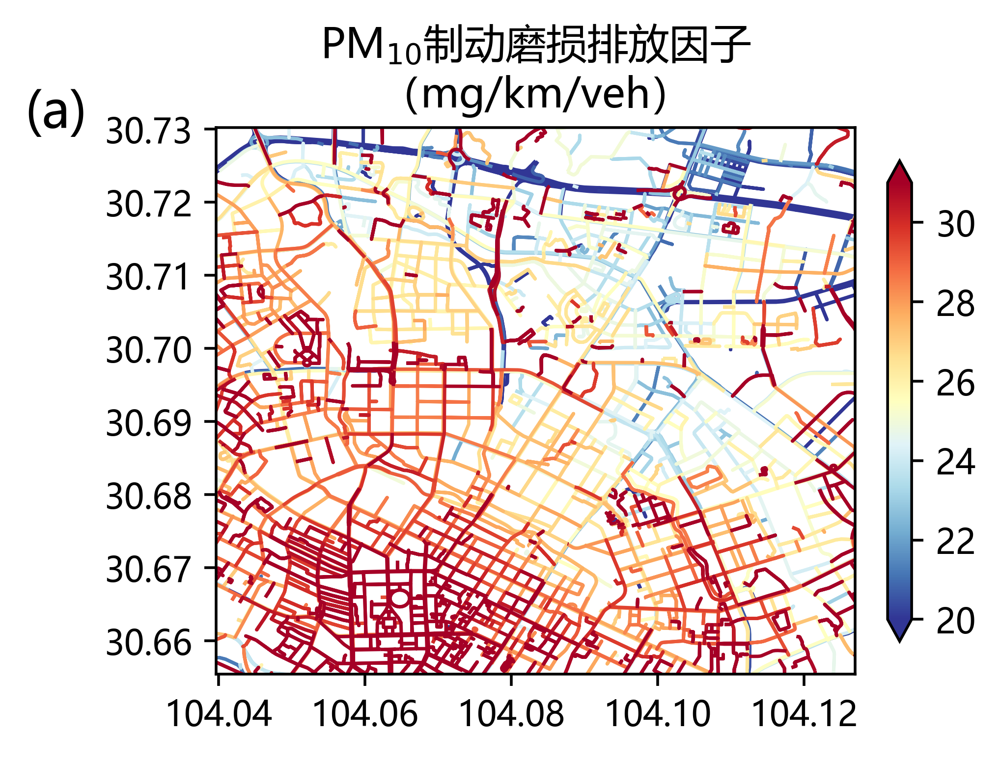

In [16]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'PM10 EF Avg', 'PM10 BWP EF [mg/vkm]', 'RdYlBu_r', 20, 31, None, agg_link)
ax.text(-0.3, 1, "(a)", transform=ax.transAxes, fontsize=15)
ax.set_title('PM$_{10}$制动磨损排放因子\n（mg/km/veh）')
plt.show()

C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_21228\2383037318.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))


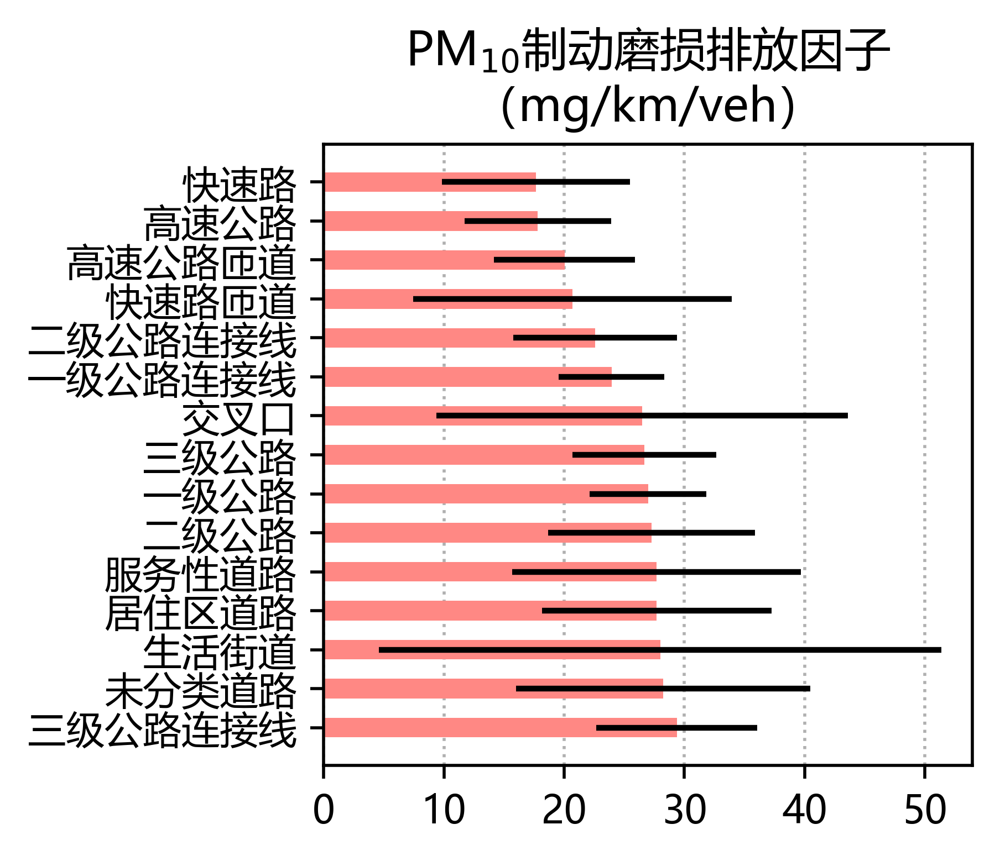

In [17]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'PM10 EF Avg', 'PM10 BWP EF [mg/vkm]', PINK,  agg_type)
ax.set_xticks(np.arange(0,55,10), np.arange(0,55,10))
ax.set_title('PM$_{10}$制动磨损排放因子\n（mg/km/veh）')
plt.show()

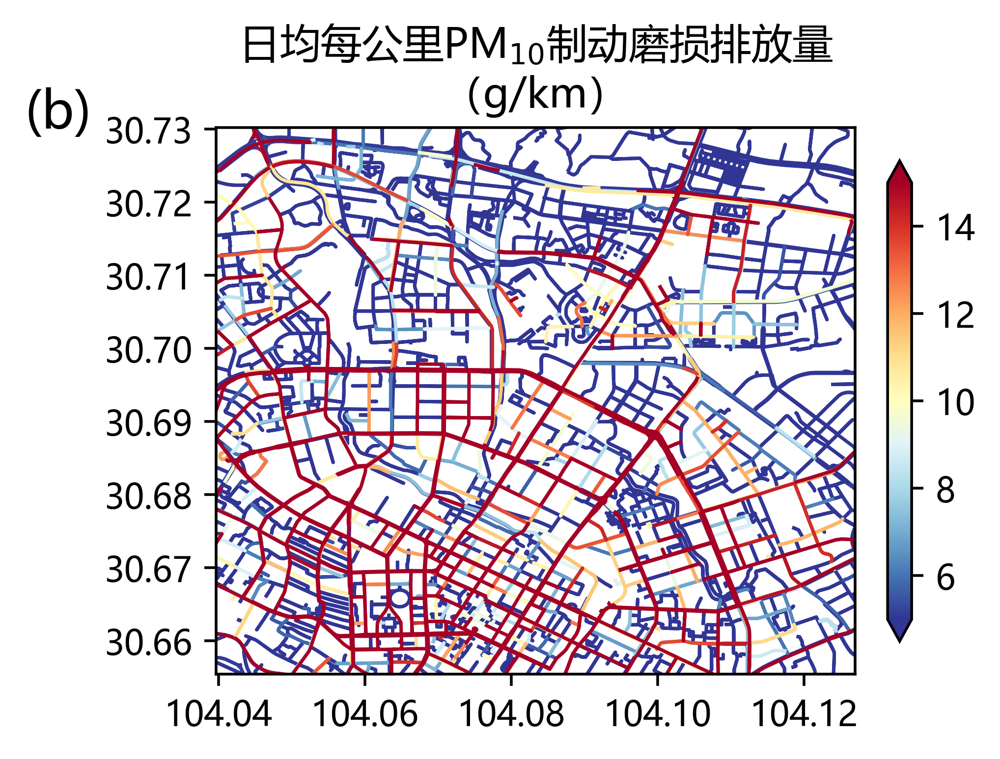

In [18]:
agg_link['BWE per km'] = agg_link['Daily BWE'] / agg_link['length'] * 1000
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)
road_heat(ax, 'BWE per km', 'Daily BWP per km [g/km]', 'RdYlBu_r', 5, 15, None, agg_link)
ax.text(-0.3, 1, "(b)", transform=ax.transAxes, fontsize=15)
ax.set_title('日均每公里PM$_{10}$制动磨损排放量\n（g/km）')
plt.show()

C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_21228\2383037318.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))


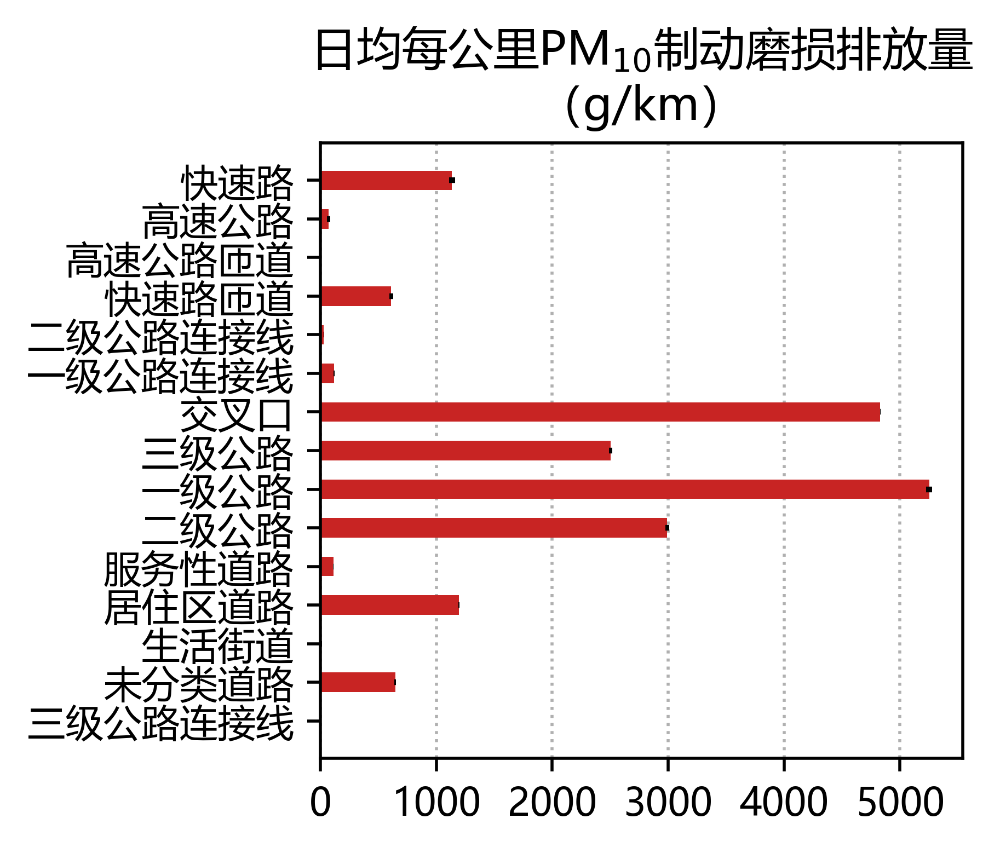

In [19]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)
type_bar(ax, 'Daily BWE', 'Daily PM10 BWE [g]', RED, agg_type)
ax.set_xticks(np.arange(0,5500,1000), np.arange(0,5500,1000))
ax.set_title('日均每公里PM$_{10}$制动磨损排放量\n（g/km）')
plt.show()

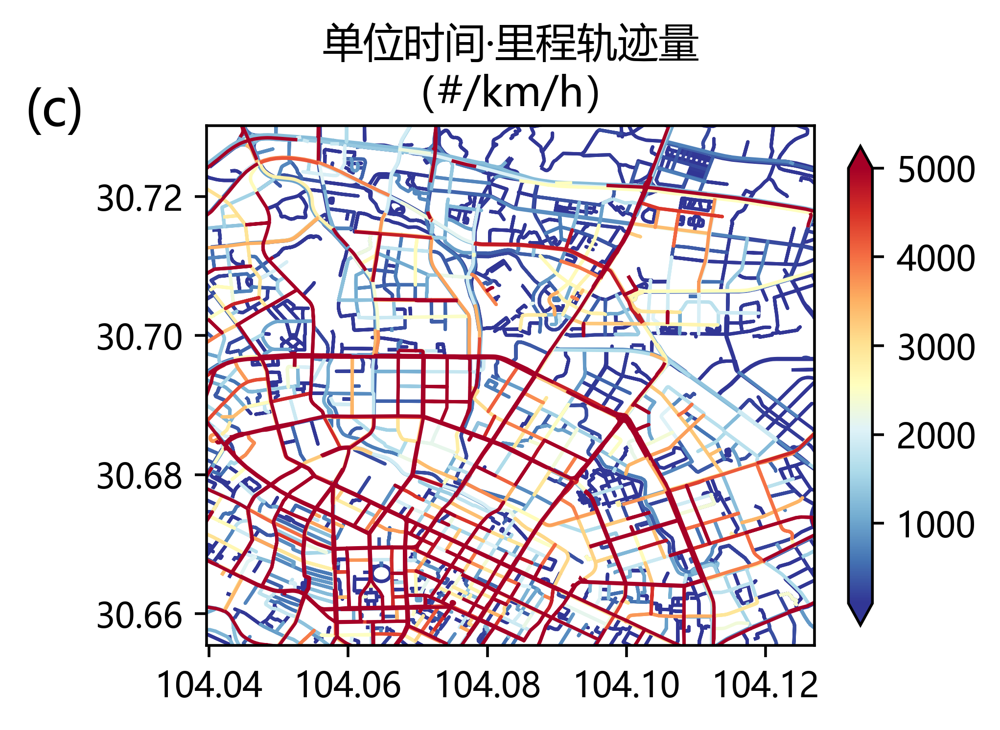

In [20]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)
road_heat(ax, 'trajVol', 'Trajectory volume [#/km/h]', 'RdYlBu_r', 100, 5000, None, agg_link)
ax.text(-0.3, 1, "(c)", transform=ax.transAxes, fontsize=15)
ax.set_title('单位时间·里程轨迹量\n（#/km/h）')
plt.show()

C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_21228\2383037318.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))


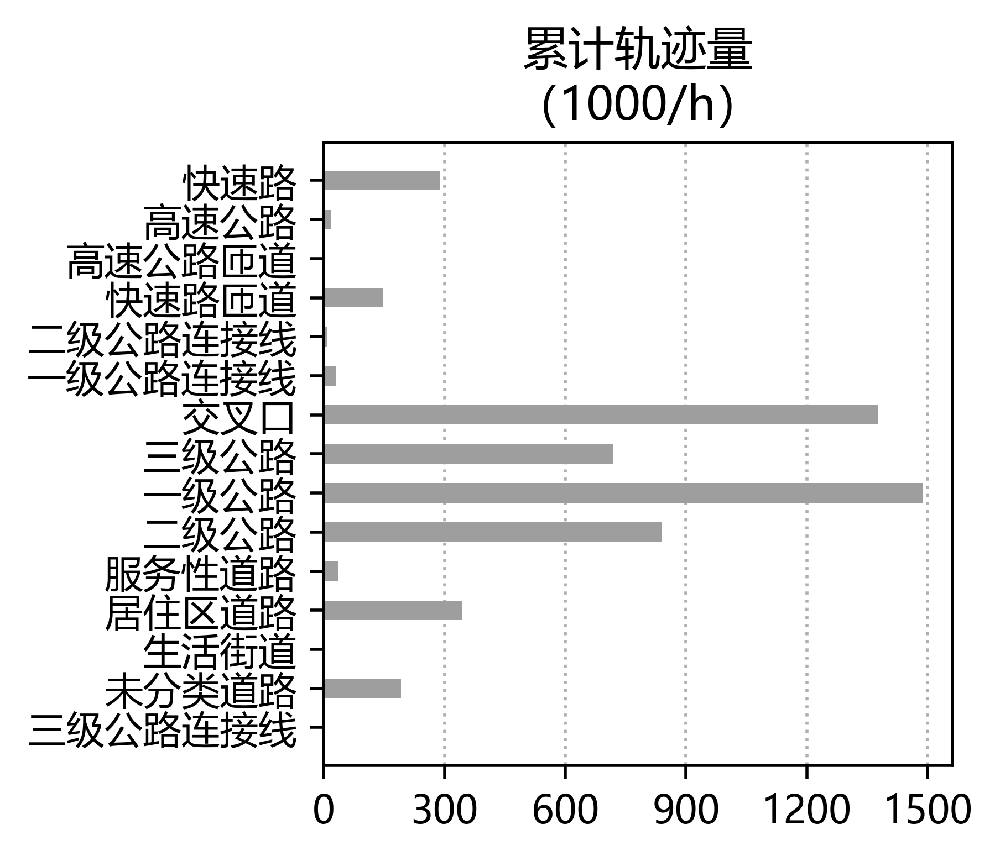

In [21]:
# trajectory per hour
agg_type['trajVol_hour'] = agg_type['trajCount'] / 30 / 24 / 1000  # #/h thousand

fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)
type_bar(ax, 'trajVol_hour', 'Cumulative traj. volume [1000/h]', GREY, agg_type, False)
ax.set_xticks(list(range(0, 1600, 300)))
ax.set_title('累计轨迹量\n（1000/h）')
plt.show()

In [70]:
def road_heat(ax, col, label, cmap, vmin, vmax, subID, agg_link):
    agg_link = agg_link.sort_values(by=col)
    agg_link.plot(ax=ax, column=col, cmap=cmap, linewidth=1, vmin=vmin, vmax=vmax, zorder=0)
    ax.set_xlim(west, east)
    ax.set_ylim(south, north)
    cbar = fig.colorbar(plt.cm.ScalarMappable(
                            norm=Normalize(vmin, vmax),
                            cmap=cmap),
                        ax=ax, location='right', shrink=0.8, extend='both')
    ax.text(-0.28, 1, subID, transform=ax.transAxes, fontsize=22)
    ax.set_title(label, fontsize=16)

def type_bar(ax, col, label, color, aggFile, error=True):
    if error:
        ax.barh(aggFile.index, aggFile[col], height=0.5, xerr=errors[col], color=color, zorder=2)
    else:
        ax.barh(aggFile.index, aggFile[col], height=0.5, color=color, zorder=2)
    ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))
    ax.set_xlabel("%s\n（按道路类型集计）" % (label), fontsize=16)
    ax.tick_params(axis='y', labelsize=13)
    ax.grid(axis='x', linestyle=":", zorder=0)
    ax.invert_yaxis()

C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_21228\3567188678.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))
C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_21228\3567188678.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))
C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_21228\3567188678.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))
C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_21228\3567188678.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(aggFile.index.map({k:v for k,v in zip(road_types, road_types_CN)}))


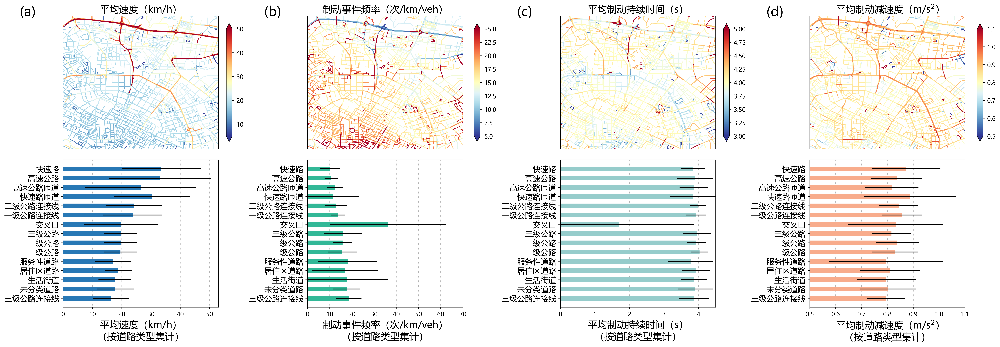

In [75]:
# fig, ax = plt.subplots(2,5, figsize=(19,5))
fig, ax = plt.subplots(2,4, figsize=(23,8), constrained_layout=True)
ax = ax.flatten()

i=0
### Avg speed heat ###
road_heat(ax[i], 'speedMean', '平均速度（km/h）', 'RdYlBu_r', 5, 50, "(a)", agg_link)

i += 1
### brake freq heat ###
road_heat(ax[i], 'brakeFreq', '制动事件频率（次/km/veh）', 'RdYlBu_r', 5, 25, "(b)", agg_link)

i += 1
### brake freq heat ###
road_heat(ax[i], 'brakeTimeMean', '平均制动持续时间（s）', 'RdYlBu_r', 3, 5, "(c)", agg_link)

i += 1
### Avg decel heat ###
road_heat(ax[i], 'brakeDecelMean', '平均制动减速度（m/s$^2$）', 'RdYlBu_r', 0.5, 1.1, "(d)", agg_link)

i += 1
### Avg speed bar ###
type_bar(ax[i], 'speedMean', '平均速度（km/h）', BLUE, agg_type)
ax[i].set_xlim(0,)

i += 1
### brake freq bar ###
type_bar(ax[i], 'brakeFreq', '制动事件频率（次/km/veh）', DEEPGREEN, agg_type)
ax[i].set_xlim(0, 70)

i += 1
### brake freq bar ###
type_bar(ax[i], 'brakeTimeMean', '平均制动持续时间（s）', GREEN, agg_type)
ax[i].set_xlim(0, 4.5)

i += 1
### Avg speed bar ###
type_bar(ax[i], 'brakeDecelMean', '平均制动减速度（m/s$^2$）', ORANGE, agg_type)
ax[i].set_xlim(0.5, 1.1)

for ax_ in [ax[i] for i in range(4)]:
    ax_.set_xticks([])
    ax_.set_yticks([])
plt.show()

In [ ]:
# fig, ax = plt.subplots(2,5, figsize=(19,5))
fig, ax = plt.subplots(4,2, figsize=(10,12))
ax = ax.flatten()

### Avg speed heat ###
road_heat(ax[0], 'speedMean', '平均速度（km/h）', 'RdYlBu_r', 5, 50, "(a)", agg_link)

### brake freq heat ###
road_heat(ax[1], 'brakeFreq', '制动事件频率（次/km/veh）', 'RdYlBu_r', 5, 25, "(b)", agg_link)

### brake freq heat ###
road_heat(ax[4], 'brakeTimeMean', '平均制动持续时间（s）', 'RdYlBu_r', 3, 5, "(c)", agg_link)

### Avg decel heat ###
road_heat(ax[5], 'brakeDecelMean', '平均制动减速度（m/s$^2$）', 'RdYlBu_r', 0.5, 1.1, "(d)", agg_link)

### Avg speed bar ###
type_bar(ax[2], 'speedMean', '平均速度（km/h）', BLUE, agg_type)
ax[i].set_xlim(0,)

### brake freq bar ###
type_bar(ax[3], 'brakeFreq', '制动事件频率（次/km/veh）', DEEPGREEN, agg_type)
ax[i].set_xlim(0, 70)

### brake freq bar ###
type_bar(ax[6], 'brakeTimeMean', '平均制动持续时间（s）', GREEN, agg_type)
ax[i].set_xlim(0, 4.5)

### Avg speed bar ###
type_bar(ax[7], 'brakeDecelMean', '平均制动减速度（m/s$^2$）', ORANGE, agg_type)
ax[i].set_xlim(0.5, 1.1)

for ax_ in [ax[i] for i in [0,1,4,5]]:
    ax_.set_xticks([])
    ax_.set_yticks([])

plt.subplots_adjust(wspace=0.8)
plt.show()

### Hotspots

In [70]:
import osmnx as ox
residential_tags = {'landuse': ['residential']}
residential_gdf = ox.features_from_bbox(north, south, east, west, residential_tags)
commercial_tags = {'landuse': ['commercial', 'retail']}
commercial_gdf = ox.features_from_bbox(north, south, east, west, commercial_tags)
education_tags = {
    'amenity': ['college', 'kindergarten', 'school', 'university'],
    'building': ['college', 'school', 'university'],
    'landuse': ['education']
}
education_gdf = ox.features_from_bbox(north, south, east, west, education_tags)
healthcare_tags = {
    'amenity': ['clinic', 'dentist', 'hospital', 'pharmacy'],
    'building': ['hospital']
}
healthcare_gdf = ox.features_from_bbox(north, south, east, west, healthcare_tags)

# colors
RESIDENTIAL = '#2878B5'
HEALTHCARE = '#DAA520'
EDUCATION = '#32B897'
COMMERCIAL = '#87CEEB'

In [71]:
from shapely import geometry

minX, minY, maxX, maxY =  west, south, east, north
x, y = (minX, minY)

geom_array = []

# hex grid
honeycomb_size = 0.008  # 890.56 meters, 2.053 square km
i = 1
while y <= maxY:
    while x <= maxX:
        geom = geometry.Polygon([(x,y-honeycomb_size), 
                                 (x+pow(3,0.5)/2*honeycomb_size, y-0.5*honeycomb_size), 
                                 (x+pow(3,0.5)/2*honeycomb_size, y+0.5*honeycomb_size), 
                                 (x,y+honeycomb_size),
                                 (x-pow(3,0.5)/2*honeycomb_size, y+0.5*honeycomb_size),
                                 (x-pow(3,0.5)/2*honeycomb_size, y-0.5*honeycomb_size), 
                                 (x,y-honeycomb_size)])
        geom_array.append(geom)
        x += pow(3,0.5)*honeycomb_size
    i += 1
    y += 1.5*honeycomb_size
    if i % 2 == 0:   
        x = minX + pow(3,0.5)/2*honeycomb_size
    else:
        x = minX
square = gpd.GeoDataFrame(geometry = geom_array,
                             crs = agg_link.crs)

# aggregate and merge
agg_grid_merge = gpd.sjoin(agg_link[['geometry', 'Daily BWE']], square, how='left', op='within')
agg_grid = agg_grid_merge.dissolve(by='index_right', aggfunc='sum')
agg_grid['geometry'] = square['geometry']

d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


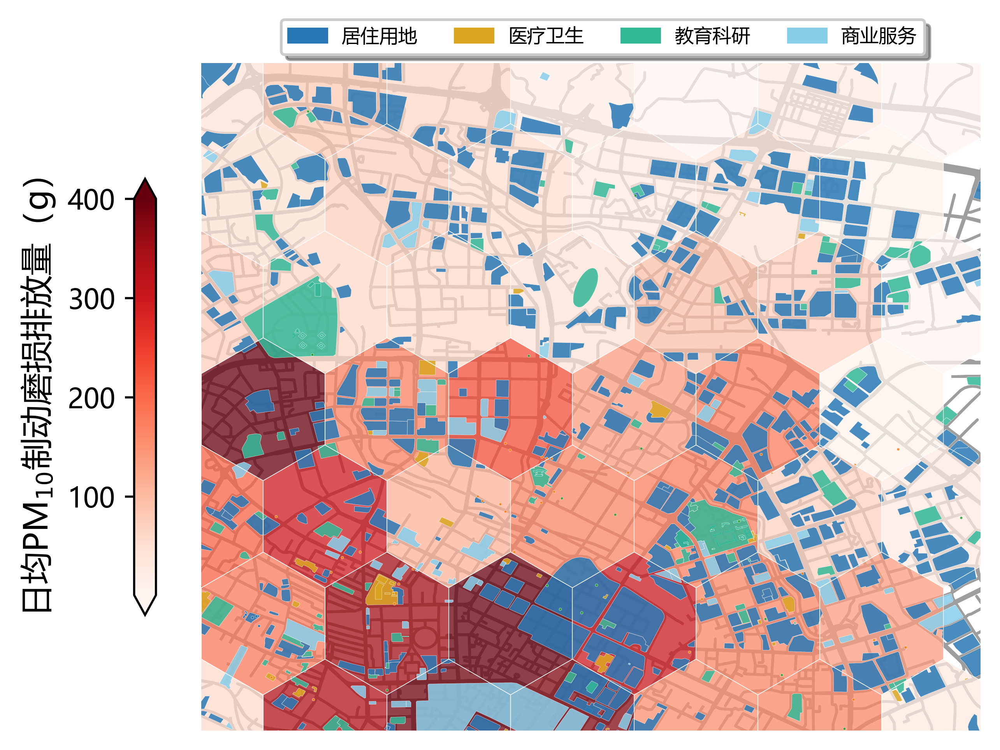

In [73]:
from matplotlib.patches import Patch

fig, ax = plt.subplots(1,1, figsize=(5,4), constrained_layout=True)

# road map
agg_link.plot(ax=ax, linewidth=1, color=GREY, alpha=1., zorder=5)

# POI
poi_gdfs = [residential_gdf, healthcare_gdf, education_gdf, commercial_gdf]
pois = ['residential', 'healthcare', 'education', 'commercial']
pois_CN = ['居住用地', '医疗卫生', '教育科研', '商业服务']
colors = [RESIDENTIAL, HEALTHCARE, EDUCATION, COMMERCIAL]
for poi, poi_CN, poi_gdf, color in zip(pois, pois_CN, poi_gdfs, colors):
    poi_gdf.plot(ax=ax, facecolor=color, edgecolor='white', linewidth=0.1, markersize=1, alpha=.85, zorder=10, label=poi_CN)

legend_elements = [Patch(facecolor=color, edgecolor=color, label=poi) for color, poi in zip(colors, pois_CN)]
ax.legend(handles=legend_elements, bbox_to_anchor=(0.94, 1.08), bbox_transform=ax.transAxes, ncol=4, fontsize=7, shadow=True)

# grid
vmin, vmax = agg_grid['Daily BWE'].min(), agg_grid['Daily BWE'].max()
label = '日均PM$_{10}$制动磨损排放量（g）'
cmap='Reds'
agg_grid.plot(ax=ax, column='Daily BWE', edgecolor='white', linewidth=0.0, cmap=cmap, vmin=vmin, vmax=400, alpha=0.75, zorder=5)
agg_grid.plot(ax=ax, edgecolor='white', facecolor='none', linewidth=0.2, zorder=15)
cbar = fig.colorbar(plt.cm.ScalarMappable(
                        norm=Normalize(vmin, 400),
                        cmap=cmap),
                    ax=ax, location='left', shrink=0.6, extend='both')
cbar.set_label(label=label, fontsize=12)

ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.axis('off')
plt.show()

In [74]:
# get number of POI in each grid
square = gpd.GeoDataFrame(geometry = geom_array, crs = 'epsg:4326')

residential_gdf['num'] = 1
gird_residential = gpd.sjoin(residential_gdf[['geometry', 'num']], square, how='left', op='within')
gird_residential = gird_residential.dissolve(by='index_right', aggfunc='sum')

commercial_gdf['num'] = 1
gird_commercial = gpd.sjoin(commercial_gdf[['geometry', 'num']], square, how='left', op='within')
gird_commercial = gird_commercial.dissolve(by='index_right', aggfunc='sum')

education_gdf['num'] = 1
gird_education = gpd.sjoin(education_gdf[['geometry', 'num']], square, how='left', op='within')
gird_education = gird_education.dissolve(by='index_right', aggfunc='sum')

healthcare_gdf['num'] = 1
gird_healthcare = gpd.sjoin(healthcare_gdf[['geometry', 'num']], square, how='left', op='within')
gird_healthcare = gird_healthcare.dissolve(by='index_right', aggfunc='sum')

# calculate num
agg_grid['residential_num'] = gird_residential['num']
agg_grid['commercial_num'] = gird_commercial['num']
agg_grid['education_num'] = gird_education['num']
agg_grid['healthcare_num'] = gird_healthcare['num']
agg_grid['poi_num'] = agg_grid['residential_num'] + agg_grid['commercial_num'] + agg_grid['education_num'] + agg_grid['healthcare_num']
agg_grid.fillna(0, inplace=True)

d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release

In [75]:
# fit linear model (poi-bwe)
from scipy.stats import linregress as LR

lines = {poi:None for poi in pois}
y = agg_grid['Daily BWE']
for poi in pois:
    x = agg_grid['%s_num'%poi]
    lines[poi] = LR(x, y, 'greater')

x = agg_grid['poi_num']
lines['poi'] = LR(x, y, 'greater')

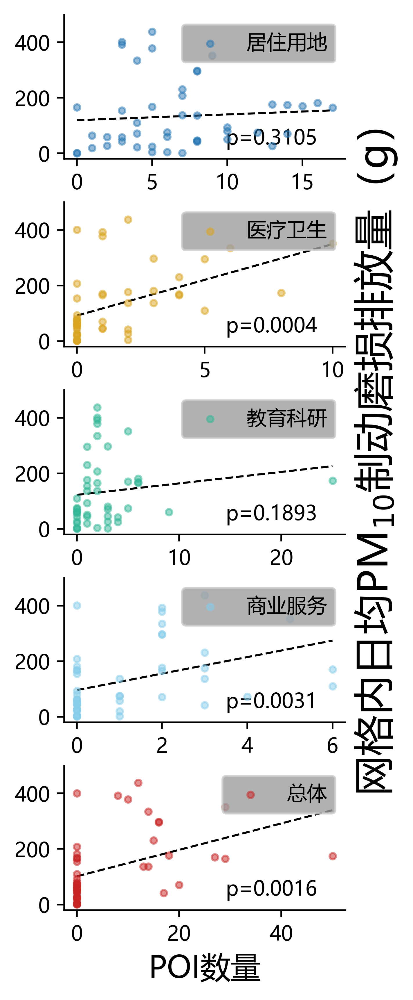

In [77]:
fig, ax = plt.subplots(5,1,figsize=(2.5,8))
ax = ax.flatten()
fig.subplots_adjust(hspace=0.3)

colors = [RESIDENTIAL, HEALTHCARE, EDUCATION, COMMERCIAL, RED]
for i, poi in enumerate(lines.keys()):
    x = np.arange(agg_grid['%s_num'%poi].min(), agg_grid['%s_num'%poi].max()+0.5, 0.5)
    ax[i].plot(x, lines[poi].intercept + lines[poi].slope*x, linewidth=1, linestyle='--', color='k')
    ax[i].scatter(agg_grid['%s_num'%poi], agg_grid['Daily BWE'], marker='o', c=colors[i], s=10, alpha=0.5, label=pois_CN[i] if i<4 else "总体", zorder=10)
    ax[i].text(0.9, 0.1, 'p=%.4f' % lines[poi].pvalue, transform = ax[i].transAxes, ha='right')

    ax[i].set_yticks(np.arange(0,500,200))
    ax[i].set_ylim(-20,500)
    ax[i].legend(loc=1, fontsize=10, facecolor=GREY).set_zorder(20)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)

ax[4].set_xlabel("POI数量", fontsize=15)
ax[2].yaxis.set_label_position("right")
ax[2].set_ylabel("网格内日均PM$_{10}$制动磨损排放量（g）", fontsize=20)
plt.show()

## Intersections

In [3]:
import pickle
with open("./data/agg/agg_node.pkl", 'rb') as f:
    agg_node = pickle.load(f)

# parameter calculation
def calParams(aggFile):
    aggFile['brakeFrac'] = aggFile['brakeCount'] / aggFile['trajCount']
    aggFile['brakeFreq'] = aggFile['brakeEventNum'] / aggFile['mileage']  # #/km
    aggFile['brakeTimeMean'] = aggFile['brakeCount'] / aggFile['brakeEventNum']  # sec
    aggFile['OpModeFrac'] = aggFile['OpModeCount'] / aggFile['trajCount']
    aggFile['brakeDecelMean'] = aggFile['brakeDecelMean'].apply(np.abs)
    aggFile['PM10 ER Avg'] = aggFile['OpModeFrac'].apply(lambda x: sum(x * OpModeERs))
    aggFile['Daily BWE'] = aggFile['PM10 ER Avg'] * aggFile['trajCount'] / 3600 / 30
    aggFile['PM10 EF Avg'] = aggFile['Daily BWE'] * 30 / aggFile['mileage'] * 1000  # mg/km/veh
    aggFile.replace(np.inf, 0, inplace=True)
    return aggFile

# calculate parameters
agg_node['brakeEventNum'] = agg_node['brakeEventNum'].astype('float32')
agg_node['brakeCount'] = agg_node['brakeCount'].astype('int32')
agg_node = calParams(agg_node)
agg_node.fillna(value=0, inplace=True)

int_col = ['trajCount', 'brakeCount', 'brakeEventNum']
float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'brakeFrac', 'brakeFreq', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
agg_node[int_col] = agg_node[int_col].astype('int32')
agg_node[float_col] = agg_node[float_col].astype('float32')

import geopandas as gpd
nodes = gpd.read_file("./data/geo/nodes/nodes.shp")

# link-level aggregation
agg_node = agg_node.join(nodes.set_index('osmid'))  # add geo info
agg_node = gpd.GeoDataFrame(agg_node, geometry='geometry')  # transfer to gdf
agg_node.fillna(value='unsignalized', inplace=True)
agg_node = agg_node[agg_node['street_cou'] > 1]  # consider >2 links only

agg_node['length'] = agg_node['street_cou'] * 20  # length
agg_node['trajVol'] = agg_node['trajCount'] / agg_node['length'] * 1000 / 30 / 24 # #/km/h

In [4]:
# generate sizes
bins = [0, 20, 40, agg_node['PM10 EF Avg'].max()]
labels = ['0-20', '20-40', '> 40']
agg_node['size_category'] = pd.cut(agg_node['PM10 EF Avg'], bins=bins, labels=labels, right=False)

size_mapping = {
    '0-20': 5,
    '20-40': 25,
    '> 40': 50
}
agg_node['sizes'] = agg_node['size_category'].map(size_mapping)

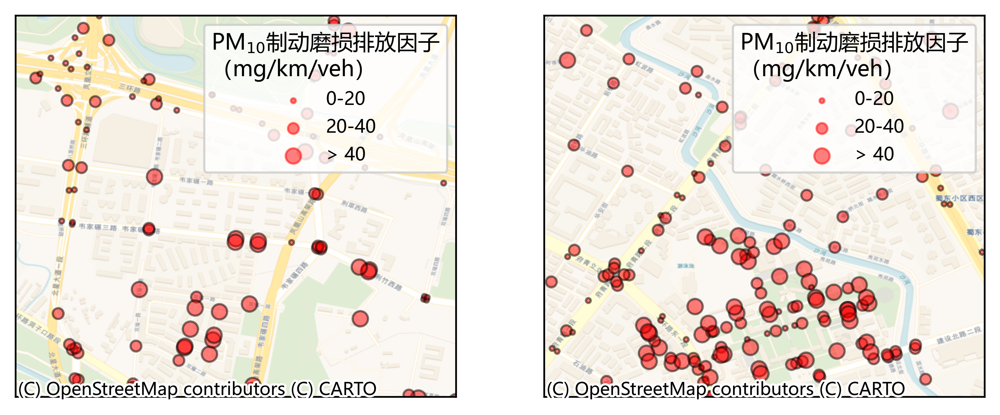

In [7]:
import contextily as ctx

fig, ax = plt.subplots(1,2, figsize=(8,4))

# fig1
agg_node.plot(ax=ax[0], color='red', edgecolor='black', markersize=agg_node['sizes'], alpha=0.5)
ax[0].set_xlim(104.07, 104.085)
ax[0].set_ylim(30.715, 30.728)
ax[0].set_xticks([])
ax[0].set_yticks([])
legend_handles = [plt.scatter([], [], s=size, color='red', alpha=0.5) for size in size_mapping.values()]
ax[0].legend(legend_handles, size_mapping.keys(), title="PM$_{10}$制动磨损排放因子\n（mg/km/veh）", scatterpoints=1, loc='upper right', fontsize='small')
ctx.add_basemap(ax=ax[0], crs=agg_node.crs.to_string(), source=ctx.providers.CartoDB.Voyager)

# fig2
agg_node.plot(ax=ax[1], color='red', edgecolor='black', markersize=agg_node['sizes'], alpha=0.5)
ax[1].set_xlim(104.09, 104.105)
ax[1].set_ylim(30.675, 30.688)
ax[1].set_xticks([])
ax[1].set_yticks([])
legend_handles = [plt.scatter([], [], s=size, color='red', alpha=0.5) for size in size_mapping.values()]
ax[1].legend(legend_handles, size_mapping.keys(), title="PM$_{10}$制动磨损排放因子\n（mg/km/veh）", scatterpoints=1, loc='upper right', fontsize='small')
ctx.add_basemap(ax=ax[1], crs=agg_node.crs.to_string(), source=ctx.providers.CartoDB.Voyager)

plt.show()

In [8]:
# generate sizes
bins = [0, 20, 40, agg_node['PM10 EF Avg'].max()]
labels = ['0-20', '20-40','> 40']
agg_node['size_category'] = pd.cut(agg_node['PM10 EF Avg'], bins=bins, labels=labels, right=False)

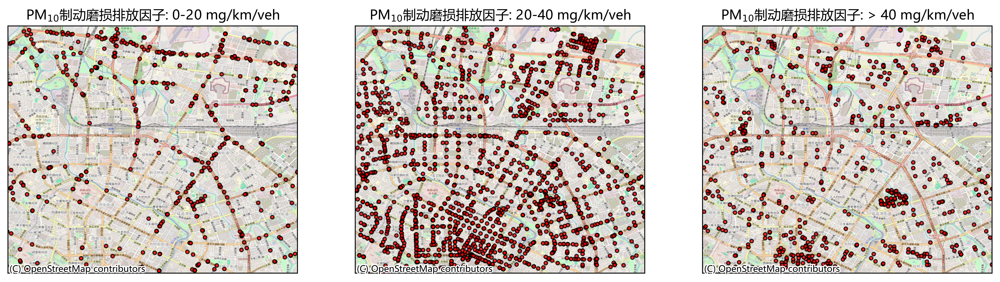

In [10]:
import contextily as ctx

fig, ax = plt.subplots(1,3, figsize=(16,6))
ax = ax.flatten()
# plot
for ax_, label in zip(ax, labels):
    agg = agg_node[agg_node['size_category'] == label]
    agg.plot(ax=ax_, color='red', edgecolor='black', markersize=10, alpha=0.8)

    # text
    ax_.set_title('PM$_{10}$制动磨损排放因子: %s mg/km/veh' % label)

    # axis
    east, west, north, south = 104.1269937640354, 104.03967976411019, 30.73017827690331, 30.655405046818046
    ax_.set_xlim(west, east)
    ax_.set_ylim(south, north)
    ax_.set_xticks([])
    ax_.set_yticks([])

    # basemap
    ctx.add_basemap(ax=ax_, crs=agg_node.crs.to_string(), source=ctx.providers.OpenStreetMap.Mapnik)
plt.show()